In [2]:
import pandas as pd, numpy as np, datetime, os, sys, pydot
import matplotlib.pyplot as plt, h5py, tensorflow as tf
from keras.models import Model
from keras.layers import Input, Dense, MaxPooling2D, MaxPooling3D, Dropout, BatchNormalization, Flatten,Conv1D, Conv2D, Conv3D, AveragePooling3D, LSTM, Reshape, ConvLSTM2D, TimeDistributed, Masking
from keras import backend as K
from keras.callbacks import History
from keras import Sequential
from keras.layers.normalization import BatchNormalization
from keras.applications import Xception
import glob, netCDF4 as nc, scipy as sc
from scipy import stats
from PIL import Image
from keras.utils import multi_gpu_model
from sklearn.metrics import mean_squared_error
from math import sqrt
from keras.utils.vis_utils import plot_model
import os
import shutil

(167, 167)


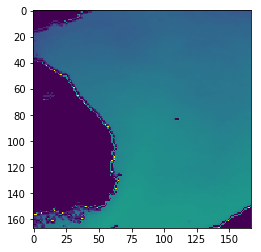

In [3]:
month = '12'
data_path = "csv/"+month
loss_path = '/home/pmimoon/Documents/ocean_conv_1/result/convlstm/'+month+'/loss_graph.png'
result_img_path = '/home/pmimoon/Documents/ocean_conv_1/result/convlstm/'+month+'/'
gt_csv_path = '/home/pmimoon/Documents/ocean_conv_1/result/csv/gt/'+month+'/'
result_csv_path = '/home/pmimoon/Documents/ocean_conv_1/result/csv/pred/'+month+'/'
result_performance_path = '/home/pmimoon/Documents/ocean_conv_1/result/convlstm/'+month+'/result.txt'
result_performance_path = '/home/pmimoon/Documents/ocean_conv_1/result/convlstm/'+month+'/result_frame.txt'

#by month, edit path.
file_list = sorted(os.listdir(data_path))#crop_20140310.daily.mer.sst.tif
for i in range(len(file_list)):
    file_list[i]=data_path+"/"+file_list[i]
#im = np.array(Image.open(file_list[0]))
im = np.loadtxt(file_list[0],delimiter = ',',dtype = np.float32)
print(im.shape)
#fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(9, 4))
plt.imshow(im)
#vmin = np.min((Y_test[0,:,:,:,2], y_predict[0,:,:,:,2]))
#vmax = np.max((Y_test[0,:,:,:,2], y_predict[0,:,:,:,2]))

#    p1 = ax[0].pcolormesh(Y_test[0,i,:,:,2], vmin=vmin, vmax=vmax)




#plt.show(ax[0].pcolormesh(im[:,:,:]))


In [4]:

vel_data = []
for i in file_list:
    #temp_img = Image.open(i)
    temp_img = np.array(np.loadtxt(i,delimiter = ',',dtype = np.float32))
    #print(temp_img.shape)
    #print(temp_img)
    #temp_img = np.array(temp_img)
    #print(temp_img)
    resize_img = np.resize(temp_img,(167,167,1))
    #print(resize_img.shape)
    vel_data.append(np.array(resize_img))
vel_data = np.array(vel_data)
print("durldu")
#print(vel_data[0,:,:].shape)
print(vel_data)
#plt.imshow(vel_data[0])
#vel = [Image.open(filename) for filename in file_list]
#print(vel)
#vel_data = np.array(vel,dtype='uint8')
#dom_size_y, dom_size_x= nc.Dataset(file_path).variables['temp'][0,:-1,:-1,0].shape
#files = nc.Dataset(file_path).variables['temp'][:,:,:,:]

#dom_size_y, dom_size_x =581,411
#print("dom_size_x : ", dom_size_x)
#print("dom_size_y : ", dom_size_y)

durldu
[[[[ 0.  ]
   [ 0.  ]
   [ 0.  ]
   ...
   [ 9.66]
   [ 9.66]
   [ 9.8 ]]

  [[ 0.  ]
   [ 0.  ]
   [ 0.  ]
   ...
   [ 9.8 ]
   [ 9.94]
   [ 9.94]]

  [[ 0.  ]
   [ 0.  ]
   [ 0.  ]
   ...
   [10.22]
   [10.22]
   [10.22]]

  ...

  [[ 3.78]
   [ 0.  ]
   [ 3.78]
   ...
   [ 0.  ]
   [ 0.  ]
   [ 0.  ]]

  [[ 5.6 ]
   [ 3.78]
   [ 3.78]
   ...
   [ 0.  ]
   [ 0.  ]
   [ 0.  ]]

  [[ 9.24]
   [11.62]
   [10.64]
   ...
   [ 0.  ]
   [ 0.  ]
   [ 0.  ]]]


 [[[ 0.  ]
   [ 0.  ]
   [ 0.  ]
   ...
   [ 9.38]
   [ 9.24]
   [ 9.38]]

  [[ 0.  ]
   [ 0.  ]
   [ 0.  ]
   ...
   [ 9.38]
   [ 9.38]
   [ 9.38]]

  [[ 0.  ]
   [ 0.  ]
   [ 0.  ]
   ...
   [ 9.66]
   [ 9.66]
   [ 9.66]]

  ...

  [[ 3.78]
   [ 0.  ]
   [ 3.78]
   ...
   [ 0.  ]
   [ 0.  ]
   [ 0.  ]]

  [[ 5.6 ]
   [ 3.78]
   [ 3.78]
   ...
   [ 0.  ]
   [ 0.  ]
   [ 0.  ]]

  [[ 5.6 ]
   [10.78]
   [ 9.94]
   ...
   [ 0.  ]
   [ 0.  ]
   [ 0.  ]]]


 [[[ 0.  ]
   [ 0.  ]
   [ 0.  ]
   ...
   [ 9.1 ]
   [ 9.1 ]
   [ 9.1 ]]



In [5]:
def make_datas(file_list, dom_size_y, dom_size_x):
    print(len(file_list))
    vel_data = np.zeros((len(file_list), dom_size_y, dom_size_x, 3))

    zero = np.zeros((dom_size_y, dom_size_x))
    
    
    #for i, file in enumerate(file_list):

        #data = nc.Dataset(file, 'r')

        #uvel = np.ma.masked_invalid(data['u'][0,0,:-1,:])
        #vvel = np.ma.masked_invalid(data['v'][0,0,:,:-1])
        #temp  = np.ma.masked_invalid(data['temp'][0,0,:-1,:-1])

        #data.close()

        #vel_data[i, :, :, 0] = file[:-1,0,0]
        #vel_data[i, :, :, 1] = file[0,:-1,0]
        #vel_data[i, :, :, 2] = file[0,0,:-1]

        #vel_data[i, :, :, 0][uvel.mask == True] = 0
        #vel_data[i, :, :, 1][vvel.mask == True] = 0
        #vel_data[i, :, :, 2][temp.mask == True] = 0
   
    return file_list


In [6]:
#raw_vels = make_datas(files, dom_size_x, dom_size_y)
raw_vels = vel_data
print(raw_vels.shape)

(759, 167, 167, 1)


In [7]:
def generate_movies(vel_set, sample, input_frame, pred_frame):
    
    movie_x, movie_y = [], []
    
    for s in range(sample):        
        frame_x, frame_y = [], []
        
        for t in range(input_frame):
            frame_x.append(vel_set[t+s,:,:,:])
            
        for t in range(pred_frame):
            frame_y.append(vel_set[input_frame+t+s,:,:,:])              
        
        movie_x.append(frame_x)
        movie_y.append(frame_y)
                  
    return np.array(movie_x), np.array(movie_y)



In [8]:


x_data, y_data = generate_movies(vel_set=raw_vels, sample=600, input_frame=6, pred_frame=6)
print(x_data.shape, y_data.shape)


(600, 6, 167, 167, 1) (600, 6, 167, 167, 1)


In [9]:

x_train, y_train = x_data[:500, :, :, :, :], y_data[:500, :, :, :, :]
x_test,  y_test  = x_data[500:, :, :, :, :], y_data[500:, :, :, :, :]

print(x_train.shape, y_train.shape)
print(x_test.shape, y_test.shape)

(500, 6, 167, 167, 1) (500, 6, 167, 167, 1)
(100, 6, 167, 167, 1) (100, 6, 167, 167, 1)


In [10]:


features = 1
'''
X_train = x_train.reshape((x_train.shape[0], x_train.shape[1], x_train.shape[2], x_train.shape[3], features))
Y_train = y_train.reshape((y_train.shape[0], y_train.shape[1], y_train.shape[2], y_train.shape[3], features))

X_test = x_test.reshape((x_test.shape[0], x_test.shape[1], x_test.shape[2], x_test.shape[3], features))
Y_test = y_test.reshape((y_test.shape[0], y_test.shape[1], y_test.shape[2], y_test.shape[3], features))
'''
X_train = x_train
Y_train = y_train
X_test = x_test
Y_test = y_test


In [11]:


print(X_train.shape, Y_train.shape, X_test.shape, Y_test.shape)


(500, 6, 167, 167, 1) (500, 6, 167, 167, 1) (100, 6, 167, 167, 1) (100, 6, 167, 167, 1)


In [12]:
gpus = tf.config.experimental.list_physical_devices('GPU')
from tensorflow.python.client import device_lib
print(device_lib.list_local_devices())
print(gpus)

[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 273865690375859270
, name: "/device:XLA_CPU:0"
device_type: "XLA_CPU"
memory_limit: 17179869184
locality {
}
incarnation: 4071030503661560195
physical_device_desc: "device: XLA_CPU device"
, name: "/device:XLA_GPU:0"
device_type: "XLA_GPU"
memory_limit: 17179869184
locality {
}
incarnation: 4379331782103702422
physical_device_desc: "device: XLA_GPU device"
, name: "/device:GPU:0"
device_type: "GPU"
memory_limit: 7358332288
locality {
  bus_id: 1
  links {
  }
}
incarnation: 12583799864544436399
physical_device_desc: "device: 0, name: GeForce RTX 2080 SUPER, pci bus id: 0000:01:00.0, compute capability: 7.5"
]
[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [13]:
from keras.utils.vis_utils import plot_model
import pydot
with tf.device('/GPU:0'):
    model = Sequential()

    input_shape = (None, X_train.shape[2], X_train.shape[3], features)

    model.add(ConvLSTM2D(filters=12, kernel_size=(3, 3), activation='linear', padding='same',input_shape=input_shape, return_sequences=True))
    model.add(BatchNormalization())
    model.add(ConvLSTM2D(filters=24, kernel_size=(3, 3), activation='linear', padding='same',return_sequences=True))
    model.add(BatchNormalization())
    model.add(ConvLSTM2D(filters=12, kernel_size=(3, 3), activation='linear', padding='same',return_sequences=True))
    model.add(BatchNormalization())
    model.add(ConvLSTM2D(filters=6, kernel_size=(3, 3), activation='linear', padding='same',return_sequences=True))
    model.add(BatchNormalization())
    model.add(ConvLSTM2D(filters=12, kernel_size=(3, 3), activation='linear', padding='same',return_sequences=True))
    model.add(BatchNormalization())
    model.add(ConvLSTM2D(filters=6, kernel_size=(3, 3), activation='linear', padding='same',return_sequences=True))
    model.add(BatchNormalization())
    #added
    #model.add(ConvLSTM2D(filters=3, kernel_size=(3, 3), activation='linear', padding='same',return_sequences=True))
    #model.add(BatchNormalization())
    #added
    model.add(ConvLSTM2D(filters=1, kernel_size=(3, 3), activation='linear', padding='same',return_sequences=True))
    model.summary()
    plot_model(model,to_file="model_plot.png",show_shapes=True,show_layer_names = True)
    #if last output is (168,168,3), then change the filter size like below 
    #model.add(ConvLSTM2D(filters=3, kernel_size=(3, 3), activation='linear', padding='same',return_sequences=True))

    #parallel_model = multi_gpu_model(model, gpus=4)

    #parallel_model.compile(loss='mse', optimizer='adam')
    model.compile(loss='mse', optimizer='adam')
    
    
    
    #history = parallel_model.fit(X_train, Y_train, batch_size=50, epochs=30, verbose=1, validation_split=0.05)
    history = model.fit(X_train, Y_train, batch_size=8, epochs=100, verbose=1, validation_split=0.05)
    

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv_lst_m2d (ConvLSTM2D)    (None, None, 167, 167, 12 5664      
_________________________________________________________________
batch_normalization (BatchNo (None, None, 167, 167, 12 48        
_________________________________________________________________
conv_lst_m2d_1 (ConvLSTM2D)  (None, None, 167, 167, 24 31200     
_________________________________________________________________
batch_normalization_1 (Batch (None, None, 167, 167, 24 96        
_________________________________________________________________
conv_lst_m2d_2 (ConvLSTM2D)  (None, None, 167, 167, 12 15600     
_________________________________________________________________
batch_normalization_2 (Batch (None, None, 167, 167, 12 48        
_________________________________________________________________
conv_lst_m2d_3 (ConvLSTM2D)  (None, None, 167, 167, 6) 3

Epoch 59/100
60/60 [==============================] - 34s 575ms/step - loss: 3.3020 - val_loss: 3.9890
Epoch 60/100
60/60 [==============================] - 34s 573ms/step - loss: 3.2762 - val_loss: 4.0520
Epoch 61/100
60/60 [==============================] - 34s 574ms/step - loss: 3.2972 - val_loss: 4.1321
Epoch 62/100
60/60 [==============================] - 34s 574ms/step - loss: 3.3646 - val_loss: 4.0116
Epoch 63/100
60/60 [==============================] - 34s 574ms/step - loss: 3.2600 - val_loss: 4.0139
Epoch 64/100
60/60 [==============================] - 34s 574ms/step - loss: 3.2372 - val_loss: 4.0596
Epoch 65/100
60/60 [==============================] - 34s 574ms/step - loss: 3.2330 - val_loss: 4.1438
Epoch 66/100
60/60 [==============================] - 34s 574ms/step - loss: 3.1673 - val_loss: 4.0064
Epoch 67/100
60/60 [==============================] - 34s 575ms/step - loss: 3.2858 - val_loss: 4.0311
Epoch 68/100
60/60 [==============================] - 34s 574ms/step - lo

In [97]:
    print(model.summary)

<bound method Model.summary of <tensorflow.python.keras.engine.sequential.Sequential object at 0x7f35b28b6a90>>


In [14]:


fig, ax = plt.subplots()

ax.plot(history.history['loss'], 'k', label='train')
ax.plot(history.history['val_loss'], 'r', label='validation')

#plt.show()
plt.savefig(loss_path)

plt.close()


In [15]:
import timeit
start_time = timeit.default_timer()
y_predict = model.predict(X_test[:,:,:,:,:])
end_time = timeit.default_timer()
print("test time for 100 sequences :", end_time-start_time)

print(y_predict.shape)

y_predict = y_predict.reshape(y_predict.shape[0], y_predict.shape[1], y_predict.shape[2], y_predict.shape[3], 1)


test time for 100 sequences : 2.821220905985683
(100, 6, 167, 167, 1)


/home/pmimoon/Documents/ocean_conv/prediction/lib/python3.5/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


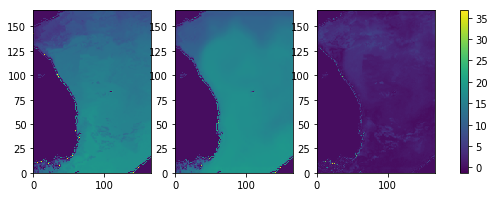

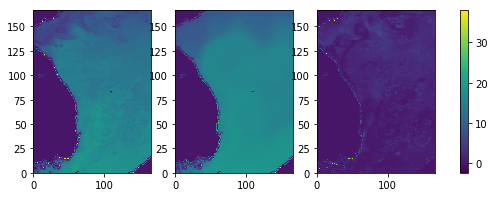

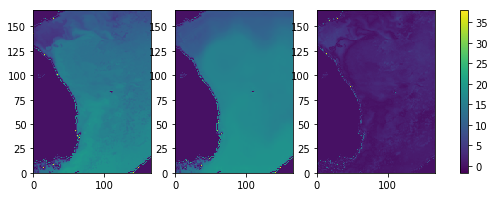

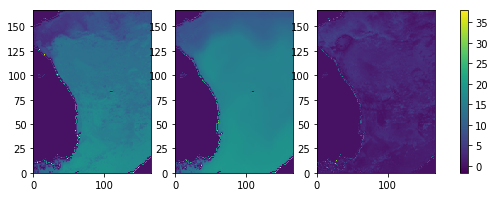

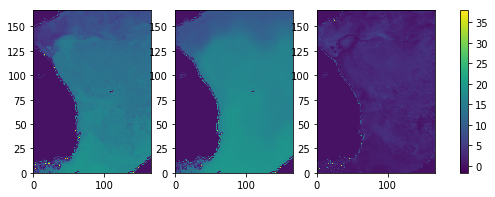

...

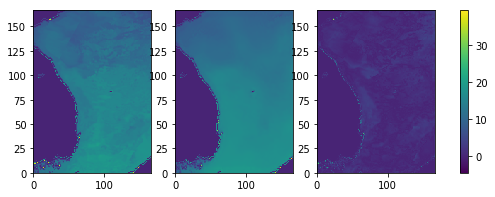

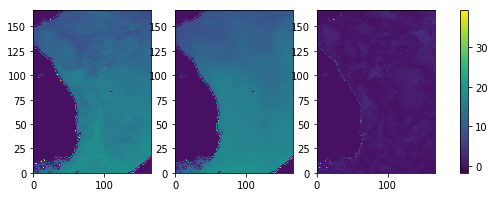

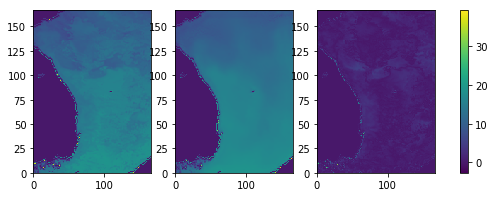

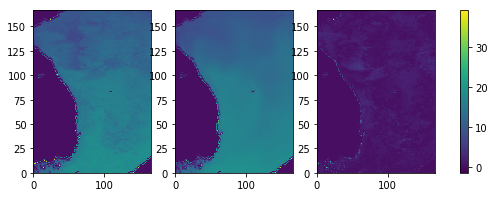

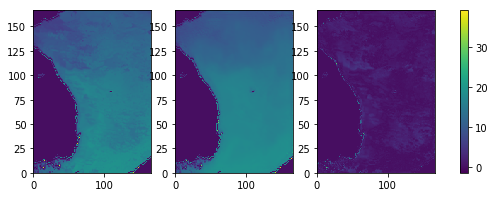

In [100]:

t = 1
for p_frame in range(100):
    for i in range(6):
        fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(9, 3))

        vmin = np.min((Y_test[p_frame,i,:,:,0], y_predict[p_frame,i,:,:,0]))
        vmax = np.max((Y_test[p_frame,i,:,:,0], y_predict[p_frame,i,:,:,0]))


        p1 = ax[0].pcolormesh(np.flipud(Y_test[p_frame,i,:,:,0]), vmin=vmin, vmax=vmax)
        p2 = ax[1].pcolormesh(np.flipud(y_predict[p_frame,i,:,:,0]), vmin=vmin, vmax=vmax)
        p3 = ax[2].pcolormesh(np.flipud(np.abs(y_predict[p_frame,i,:,:,0]-Y_test[p_frame,i,:,:,0])),vmin=vmin,vmax=vmax)
        fig.colorbar(p1, ax=ax.ravel().tolist())
        plt.savefig(result_img_path+str(p_frame)+"_"+str(i)+".png")
        




In [102]:
import math
#result_f = open('/home/pmimoon/Documents/ocean_conv_1/result/convlstm/04/result.txt','w')
#result_performance_path = '/home/pmimoon/Documents/ocean_conv_1/result/convlstm/'+month+'/result.txt'
result_f = open(result_performance_path,'w')
###Function for calculate Correlation
def np_crop_by_n_block(img,padding,npad):
    #padding = 1
    #npad=((1,0),(1,0))###(upper side,down side),(left side,right side)
    img_padding = np.pad(img,npad,'constant',constant_values=(0))#constant values means "i will pad to image by value 0!"
    sp_by_img = np.split(img_padding,7)
    arr_img = np.array([np.split(x,7,1) for x in sp_by_img])#7X7 crop block list arr
    return arr_img

def cal_cor(img1, img2):
    return np.multiply(img2,img1).sum()/np.sqrt(np.multiply(np.square(img1).sum(),np.square(img2).sum()))

def cal_all_crop_block_cor(img1,img2,w,h):#w = width, h = height
    #calculate correlation between gt&predicted image
    #two images are cropped by block that is N X N
    #we calculate each block correlation and finally caculate average correlation in N X N blocks
    COR = 0
    for pixel_x in range(w):
        for pixel_y in range(h):
            #temp = np.multiply(img2[pixel_x][pixel_y],img1[pixel_x][pixel_y]).sum()/(math.sqrt(np.square(img1[pixel_x][pixel_y]).sum()*np.square(img2[pixel_x][pixel_y]).sum())+0.0000001)
            #upper = np.multiply(img2[pixel_x][pixel_y],img1[pixel_x][pixel_y]).sum()
            #down = math.sqrt(np.square(img1[pixel_x][pixel_y]).sum()*np.square(img2[pixel_x][pixel_y]).sum())+0.0001 
#            print("upper",upper)
#            print("down",down)
            #print(temp)
            if (img1[pixel_x][pixel_y]==img2[pixel_x][pixel_y]).all():
                COR = COR + 1.0
            else:
                COR = COR + np.multiply(img2[pixel_x][pixel_y],img1[pixel_x][pixel_y]).sum()/(math.sqrt(np.square(img1[pixel_x][pixel_y]).sum()*np.square(img2[pixel_x][pixel_y]).sum())+0.0000001)
    return COR/(w*h)
###Function for calculate Correlation

total_RMSE = 0
total_MSE = 0
total_MAE = 0
total_COR = 0


for p_frame in range(100):
    RMSE = 0
    MSE = 0
    MAE = 0
    COR = 0#CORRELATION
    avg_rmse = 0
    avg_mse = 0
    avg_mae = 0
    avg_cor = 0
    rmse_list = []
    mse_list = []
    mae_list =[]
    cor_list = []

    for i in range(6):
        img1 = Y_test[p_frame,i,:,:,0]
        img2 = y_predict[p_frame,i,:,:,0]
        

        ########image crop and calculate correlation
        padding = 1
        npad=((1,0),(1,0))###(upper side,down side),(left side,right side)
        arr_img1 = np_crop_by_n_block(img1,padding,npad)
        arr_img2 = np_crop_by_n_block(img2,padding,npad)
    
        COR = cal_all_crop_block_cor(arr_img1,arr_img2,7,7)
        #COR = COR/49        
        ########image crop and calculate correlation
        RMSE = np.sqrt(np.mean((img2-img1)**2))
        MAE = np.mean(np.abs(img2-img1))
        MSE = np.mean((img2-img1)**2)
        #COR = np.multiply(img2,img1).sum()/np.sqrt(np.multiply(np.square(img1).sum(),np.square(img2).sum()))
        #COR = np.multiply(arr_img2[6][6],arr_img1[6][6]).sum()/np.sqrt(np.multiply(np.square(arr_img1[6][6]).sum(),np.square(arr_img2[6][6]).sum()))
        avg_rmse += RMSE
        avg_mse += MSE
        avg_mae += MAE
        avg_cor += COR
        rmse_list.append(RMSE)
        mse_list.append(MSE)
        mae_list.append(MAE)
        cor_list.append(COR)
        #print("RMSE: ", RMSE)
        #print("MSE: ",MSE)
        #print("MAE: ",MAE)
    for i in range(len(rmse_list)):
        print("RMSE for frame",i+7,":",rmse_list[i])
    for i in range(len(mse_list)):
        print("MSE for frame",i+7,":",mse_list[i])
    for i in range(len(mae_list)):
        print("MAE for frame",i+7,":",mae_list[i])
    for i in range(len(cor_list)):
        print("CORRELATION for frame",i+7,":",cor_list[i])

    #print("average RMSE:", avg_rmse/6)
    #print("average MSE:", avg_mse/6)
    #print("average MAE:", avg_mae/6)
    #print("average COR:", avg_cor/6)
    print(p_frame)
    result_rmse = "average RMSE for sequence-" + str(p_frame) +  " : " + str(avg_rmse/6) + "\n"
    result_mse = "average MSE for sequence-" + str(p_frame) +  " : " + str(avg_mse/6) + "\n"
    result_mae = "average MAE for sequence-" + str(p_frame) +  " : " + str(avg_mae/6) + "\n"
    result_cor = "average Correlation for sequence-" + str(p_frame) + " : " + str(avg_cor/6) + "\n"
    result_f.write(result_rmse)
    result_f.write(result_mse)
    result_f.write(result_mae)
    result_f.write(result_cor)
    
    total_RMSE += avg_rmse/6
    total_MSE += avg_mse/6
    total_MAE += avg_mae/6
    total_COR += avg_cor/6

result_f.write("total RMSE : "+str(total_RMSE/100)+"\n")
result_f.write("total MSE : "+str(total_MSE/100)+"\n")
result_f.write("total MAE : "+str(total_MAE/100)+"\n")
result_f.write("total Correlation : "+str(total_COR/100)+"\n")

result_f.close()
# In[20]:
'''

y_pred = nc.Dataset('./temp_result.nc','w',format="NETCDF4")#format="NETCDF4"  ++++added++++

y_pred.createDimension('t', None)
y_pred.createDimension('idy', 165)
y_pred.createDimension('idx', 167)
y_pred.createDimension('filter', 3)
y_pred.createDimension('frame',6)

pred = y_pred.createVariable('pred','f4',('t', 'frame', 'idy', 'idx', 'filter'))
test = y_pred.createVariable('test','f4',('t', 'frame', 'idy', 'idx', 'filter'))

pred[:] = y_predict
test[:] = y_test

y_pred.close()
'''

RMSE for frame 7 : 2.085629
RMSE for frame 8 : 2.088639
RMSE for frame 9 : 1.9186534
RMSE for frame 10 : 2.3442829
RMSE for frame 11 : 2.3639336
RMSE for frame 12 : 2.4443948
MSE for frame 7 : 4.3498483
MSE for frame 8 : 4.3624134
MSE for frame 9 : 3.6812305
MSE for frame 10 : 5.4956627
MSE for frame 11 : 5.588182
MSE for frame 12 : 5.9750657
MAE for frame 7 : 1.4747229
MAE for frame 8 : 1.4064509
MAE for frame 9 : 1.3355745
MAE for frame 10 : 1.7605287
MAE for frame 11 : 1.7984695
MAE for frame 12 : 1.8086913
CORRELATION for frame 7 : 0.9878808900351431
CORRELATION for frame 8 : 0.9806943097192121
CORRELATION for frame 9 : 0.9834630142047838
CORRELATION for frame 10 : 0.98103722031434
CORRELATION for frame 11 : 0.9824871168197583
CORRELATION for frame 12 : 0.9776697380864847
0
RMSE for frame 7 : 1.952939
RMSE for frame 8 : 1.8372056
RMSE for frame 9 : 2.1833868
RMSE for frame 10 : 2.226125
RMSE for frame 11 : 2.3507872
RMSE for frame 12 : 2.2305548
MSE for frame 7 : 3.813971
MSE for f

RMSE for frame 7 : 2.0863118
RMSE for frame 8 : 1.3966585
RMSE for frame 9 : 1.6808051
RMSE for frame 10 : 1.5148247
RMSE for frame 11 : 1.4615018
RMSE for frame 12 : 1.6207094
MSE for frame 7 : 4.352697
MSE for frame 8 : 1.9506551
MSE for frame 9 : 2.8251057
MSE for frame 10 : 2.2946942
MSE for frame 11 : 2.1359875
MSE for frame 12 : 2.626699
MAE for frame 7 : 1.3574706
MAE for frame 8 : 0.84451544
MAE for frame 9 : 1.022047
MAE for frame 10 : 0.93279463
MAE for frame 11 : 0.9203884
MAE for frame 12 : 1.0616922
CORRELATION for frame 7 : 0.9856507611713732
CORRELATION for frame 8 : 0.9890480665672153
CORRELATION for frame 9 : 0.9846293607352369
CORRELATION for frame 10 : 0.986753291405022
CORRELATION for frame 11 : 0.989297503306241
CORRELATION for frame 12 : 0.9894432144216863
15
RMSE for frame 7 : 1.8906635
RMSE for frame 8 : 2.1556342
RMSE for frame 9 : 1.9566889
RMSE for frame 10 : 1.8814554
RMSE for frame 11 : 1.9732467
RMSE for frame 12 : 2.1628146
MSE for frame 7 : 3.5746086
MSE

RMSE for frame 8 : 2.202462
RMSE for frame 9 : 2.2591052
RMSE for frame 10 : 2.0998914
RMSE for frame 11 : 2.9465196
RMSE for frame 12 : 2.5833657
MSE for frame 7 : 3.6251028
MSE for frame 8 : 4.850838
MSE for frame 9 : 5.1035566
MSE for frame 10 : 4.4095445
MSE for frame 11 : 8.681977
MSE for frame 12 : 6.6737785
MAE for frame 7 : 1.2829251
MAE for frame 8 : 1.5648348
MAE for frame 9 : 1.5587658
MAE for frame 10 : 1.5079561
MAE for frame 11 : 2.1972466
MAE for frame 12 : 1.978121
CORRELATION for frame 7 : 0.983345880881105
CORRELATION for frame 8 : 0.9823987238607145
CORRELATION for frame 9 : 0.9740900804339474
CORRELATION for frame 10 : 0.9766778534595373
CORRELATION for frame 11 : 0.9716011510710816
CORRELATION for frame 12 : 0.9835215225113464
30
RMSE for frame 7 : 2.2052605
RMSE for frame 8 : 2.2752807
RMSE for frame 9 : 2.049454
RMSE for frame 10 : 2.885031
RMSE for frame 11 : 2.554342
RMSE for frame 12 : 2.6724794
MSE for frame 7 : 4.8631744
MSE for frame 8 : 5.176902
MSE for fr

RMSE for frame 7 : 2.1009057
RMSE for frame 8 : 1.3247482
RMSE for frame 9 : 1.3097478
RMSE for frame 10 : 1.454948
RMSE for frame 11 : 2.1880002
RMSE for frame 12 : 1.6183456
MSE for frame 7 : 4.4138045
MSE for frame 8 : 1.7549578
MSE for frame 9 : 1.7154392
MSE for frame 10 : 2.1168735
MSE for frame 11 : 4.7873445
MSE for frame 12 : 2.6190424
MAE for frame 7 : 1.4907824
MAE for frame 8 : 0.7563809
MAE for frame 9 : 0.75988036
MAE for frame 10 : 0.90403306
MAE for frame 11 : 1.5175399
MAE for frame 12 : 1.0281801
CORRELATION for frame 7 : 0.9855558052692687
CORRELATION for frame 8 : 0.9883853322872446
CORRELATION for frame 9 : 0.9897331846662173
CORRELATION for frame 10 : 0.9904055674318795
CORRELATION for frame 11 : 0.9863030562674661
CORRELATION for frame 12 : 0.9848798675954408
46
RMSE for frame 7 : 1.7077701
RMSE for frame 8 : 1.6648321
RMSE for frame 9 : 1.6147696
RMSE for frame 10 : 2.5681286
RMSE for frame 11 : 1.8721284
RMSE for frame 12 : 1.8253231
MSE for frame 7 : 2.9164786

RMSE for frame 7 : 2.101989
RMSE for frame 8 : 1.9200158
RMSE for frame 9 : 2.100206
RMSE for frame 10 : 1.7110875
RMSE for frame 11 : 1.8261224
RMSE for frame 12 : 1.7605238
MSE for frame 7 : 4.418358
MSE for frame 8 : 3.6864607
MSE for frame 9 : 4.4108653
MSE for frame 10 : 2.9278204
MSE for frame 11 : 3.3347232
MSE for frame 12 : 3.0994442
MAE for frame 7 : 1.4454217
MAE for frame 8 : 1.2907028
MAE for frame 9 : 1.5316004
MAE for frame 10 : 1.2542824
MAE for frame 11 : 1.3423214
MAE for frame 12 : 1.0791339
CORRELATION for frame 7 : 0.9828977529806076
CORRELATION for frame 8 : 0.9834232745180881
CORRELATION for frame 9 : 0.9840980985789163
CORRELATION for frame 10 : 0.9892534275316219
CORRELATION for frame 11 : 0.9890619677576121
CORRELATION for frame 12 : 0.990729325424503
62
RMSE for frame 7 : 1.9568332
RMSE for frame 8 : 2.0837188
RMSE for frame 9 : 1.6734966
RMSE for frame 10 : 1.8044709
RMSE for frame 11 : 1.702199
RMSE for frame 12 : 1.7556691
MSE for frame 7 : 3.8291962
MSE f

RMSE for frame 11 : 1.7052563
RMSE for frame 12 : 1.7806735
MSE for frame 7 : 2.0174484
MSE for frame 8 : 1.5805098
MSE for frame 9 : 1.8644809
MSE for frame 10 : 3.0863457
MSE for frame 11 : 2.9078994
MSE for frame 12 : 3.1707983
MAE for frame 7 : 0.852297
MAE for frame 8 : 0.735241
MAE for frame 9 : 0.85974646
MAE for frame 10 : 1.1757175
MAE for frame 11 : 1.2014788
MAE for frame 12 : 1.2705107
CORRELATION for frame 7 : 0.9821605044442024
CORRELATION for frame 8 : 0.991228395921171
CORRELATION for frame 9 : 0.9912514268712513
CORRELATION for frame 10 : 0.9905669315269796
CORRELATION for frame 11 : 0.9906665519148236
CORRELATION for frame 12 : 0.9906106921077931
77
RMSE for frame 7 : 1.2495787
RMSE for frame 8 : 1.3508898
RMSE for frame 9 : 1.662918
RMSE for frame 10 : 1.6201304
RMSE for frame 11 : 1.7323722
RMSE for frame 12 : 1.6252375
MSE for frame 7 : 1.561447
MSE for frame 8 : 1.8249032
MSE for frame 9 : 2.7652962
MSE for frame 10 : 2.6248226
MSE for frame 11 : 3.0011132
MSE for

RMSE for frame 7 : 1.7248747
RMSE for frame 8 : 1.7044243
RMSE for frame 9 : 1.7359389
RMSE for frame 10 : 2.0674746
RMSE for frame 11 : 1.8459187
RMSE for frame 12 : 1.3925084
MSE for frame 7 : 2.975193
MSE for frame 8 : 2.9050622
MSE for frame 9 : 3.013484
MSE for frame 10 : 4.2744513
MSE for frame 11 : 3.4074159
MSE for frame 12 : 1.9390796
MAE for frame 7 : 1.1636308
MAE for frame 8 : 1.1613746
MAE for frame 9 : 1.1791898
MAE for frame 10 : 1.4000436
MAE for frame 11 : 1.2900152
MAE for frame 12 : 0.8216699
CORRELATION for frame 7 : 0.9840574587234224
CORRELATION for frame 8 : 0.985158441694531
CORRELATION for frame 9 : 0.9857453084131123
CORRELATION for frame 10 : 0.9821251834899392
CORRELATION for frame 11 : 0.9860736520671053
CORRELATION for frame 12 : 0.9870716593524088
93
RMSE for frame 7 : 1.7244551
RMSE for frame 8 : 1.7537566
RMSE for frame 9 : 2.037979
RMSE for frame 10 : 1.8041284
RMSE for frame 11 : 1.4124571
RMSE for frame 12 : 1.7339234
MSE for frame 7 : 2.9737456
MSE 

'\n\ny_pred = nc.Dataset(\'./temp_result.nc\',\'w\',format="NETCDF4")#format="NETCDF4"  ++++added++++\n\ny_pred.createDimension(\'t\', None)\ny_pred.createDimension(\'idy\', 165)\ny_pred.createDimension(\'idx\', 167)\ny_pred.createDimension(\'filter\', 3)\ny_pred.createDimension(\'frame\',6)\n\npred = y_pred.createVariable(\'pred\',\'f4\',(\'t\', \'frame\', \'idy\', \'idx\', \'filter\'))\ntest = y_pred.createVariable(\'test\',\'f4\',(\'t\', \'frame\', \'idy\', \'idx\', \'filter\'))\n\npred[:] = y_predict\ntest[:] = y_test\n\ny_pred.close()\n'